# COVID.txt - Using NLP to identify topics within academic literature around lockdown & quarantine

## Contents

* [0. Introduction](#introduction)
* [1. Setup](#setup)
* [2. Data processing](#data-processing)
* [3. Using word embeddings to find additional keywords](#word-embeddings)
* [4. Querying the corpus to find relevant sentences around lockdown and quarantine](#query)
* [5. Topic modelling of relevant sentences using BERT](#topic-modelling)
* [6. Topic example sentences & papers](#topic-examples)
* [7. Generate topic word clouds](#word-clouds)

## 0. Introduction <a class="anchor" id="introduction"></a>

## 1. Setup <a class="anchor" id="setup"></a>

In [3]:
# Imports
# Utility packages
import os
import zipfile
import itertools
import string
from tqdm import tqdm
import re

# NLP & text mining packages
import fasttext
import fasttext.util
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
import nltk
from wordcloud import WordCloud, STOPWORDS

# Data analysis & ML packages
import pandas as pd
import numpy as np
import tensorflow as tf
import umap
import hdbscan

import matplotlib.pyplot as plt
%matplotlib inline

nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/jonathanhowells/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [6]:
# Extract data
DATA_DIR = os.path.join('..', '..', 'data')
ARCHIVE_ZIP = os.path.join(DATA_DIR, 'archive.zip')
ARCHIVE_DIR = os.path.join(DATA_DIR, 'archive')

RESULTS_ZIP = os.path.join(DATA_DIR, 'results.zip')
RESULTS_DIR = os.path.join(DATA_DIR, 'results')

In [ ]:
with zipfile.ZipFile(ARCHIVE_ZIP, 'r') as zip_ref:
    zip_ref.extractall(ARCHIVE_DIR)
    
with zipfile.ZipFile(RESULTS_ZIP, 'r') as zip_ref:
    zip_ref.extractall(RESULTS_DIR)

In [7]:
# Metadata README
metadata_readme = os.path.abspath(os.path.join(ARCHIVE_DIR, 'metadata.readme'))
with open(metadata_readme) as f: print(f.read())

2020-12-17

---CHANGES---

No major changes.


---SUMMARY---
total metadata rows: 388047
CORD UIDs (new: 6043, removed: 108)

Full text:
  PDF - 141673 json (new: 1750, removed: 85)
  PMC - 104130 json (new: 1146)

---------------------------

2020-12-13

---CHANGES---

No major changes.


---SUMMARY---
total metadata rows: 381817
CORD UIDs (new: 1727, removed: 3)

Full text:
  PDF - 140007 json (new: 215, removed: 567)
  PMC - 102984 json (new: 0)

---------------------------
2020-12-12

---CHANGES---

No major changes.


---SUMMARY---
total metadata rows: 379974
CORD UIDs (new: 381, removed: 9)

Full text:
  PDF - 140358 json (new: 267, removed: 23)
  PMC - 102984 json (new: 57, removed: 1)

---------------------------
2020-12-11

---CHANGES---

No major changes.


---SUMMARY---
total metadata rows: 379579
CORD UIDs (new: 1334, removed: 58)

Full text:
  PDF - 140113 json (new: 1272, removed: 83)
  PMC - 102928 json (new: 338)

---------------------------


2020-12-10

---CHANGES---


In [8]:
# JSON Schema
json_schema = os.path.abspath(os.path.join(ARCHIVE_DIR, 'json_schema.txt'))
with open(json_schema) as f: print(f.read())

# JSON schema of full text documents


{
    "paper_id": <str>,                      # 40-character sha1 of the PDF
    "metadata": {
        "title": <str>,
        "authors": [                        # list of author dicts, in order
            {
                "first": <str>,
                "middle": <list of str>,
                "last": <str>,
                "suffix": <str>,
                "affiliation": <dict>,
                "email": <str>
            },
            ...
        ],
        "abstract": [                       # list of paragraphs in the abstract
            {
                "text": <str>,
                "cite_spans": [             # list of character indices of inline citations
                                            # e.g. citation "[7]" occurs at positions 151-154 in "text"
                                            #      linked to bibliography entry BIBREF3
                    {
                        "start": 151,
                        "end": 1

In [393]:
# Metadata
metadata_df = pd.read_csv(os.path.join(ARCHIVE_DIR, 'metadata.csv'), low_memory=False)
metadata_df.head()

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,PMC,Surfactant protein-D and pulmonary host defense,10.1186/rr19,PMC59549,11667972,no-cc,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/06ced00a5fc04215949aa...,document_parses/pmc_json/PMC59549.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,PMC,Role of endothelin-1 in lung disease,10.1186/rr44,PMC59574,11686871,no-cc,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/348055649b6b8cf2b9a37...,document_parses/pmc_json/PMC59574.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,PMC,Gene expression in epithelial cells in respons...,10.1186/rr61,PMC59580,11686888,no-cc,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/5f48792a5fa08bed9f560...,document_parses/pmc_json/PMC59580.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


## 2. Data Processing <a class="anchor" id="data-processing"></a>

In [9]:
biorxiv_clean = pd.read_csv(RESULTS_DIR + '/biorxiv_clean.csv')
clean_comm_use = pd.read_csv(RESULTS_DIR + '/clean_comm_use.csv')
clean_noncomm_use = pd.read_csv(RESULTS_DIR + '/clean_noncomm_use.csv')
clean_pmc = pd.read_csv(RESULTS_DIR + '/clean_pmc.csv')

In [76]:
corpus_df = pd.concat([biorxiv_clean, clean_comm_use, clean_noncomm_use, clean_pmc])

In [137]:
keywords = ['quarantine', 'stay-at-home', 'shelter-in-place', 'shutdown', 'lockdown']

### Clean Text 

In [138]:
def clean_sentence(sentence):
    # Remove titles before linespaces
    try:
        clean_sentence = re.findall('\n\n(.*)', sentence)[-1]
    except IndexError:
        clean_sentence = sentence
    
    return clean_sentence

def clean_sentences(sentences):
    
    cleaned_sentences = [clean_sentence(sentence) for sentence in sentences]
    
    # Remove sentences with only punctuation
    cleaned_sentences_no_punctuation = [sentence for sentence in cleaned_sentences if sentence not in string.punctuation]
    
    return cleaned_sentences_no_punctuation

In [355]:
corpus = corpus_df[['paper_id', 'text']].values

# Retain the paper ID throughout the analysis.
# The paper ID can be re-used to refer back to the relevant paper.
corpus = [(paper_id, document) for paper_id, document in corpus if type(document)==str]

In [357]:
# Split into sentences for each article in the corpus
documents = [(paper_id, nltk.sent_tokenize(document)) for paper_id, document in corpus]

In [371]:
# Clean each sentence
documents_clean = [(paper_id, clean_sentences(document)) for paper_id, document in documents]

In [378]:
sentence2paper = {}

for paper_id, doc in documents_clean:
    for sentence in doc:
        sentence2paper[sentence] = paper_id

In [ ]:
# Flatten documents into a list of sentences
sentences_clean = [item for sublist in documents_clean for item in sublist]

## 3. Using word embeddings to find additional keywords <a class="anchor" id="word-embeddings"></a>

In [ ]:
# We will use FastText for pre-trained word-embeddings.
# As training word embeddings from the CORD-19 corpus and finding
# words with similar embeddings will be computationally expensive.
fasttext.util.download_model('en', if_exists='ignore')  # English
ft = fasttext.load_model('cc.en.300.bin')

In [ ]:
# Word embeddings can be used to return words that are close within the vector space
print(keywords[0])
ft.get_nearest_neighbors(keywords[0])

In [141]:
keywords_extended = []
for keyword in keywords:
    keywords_extended.append(keyword)
    
    nearest_neighbours = [word.lower() for similarity, word in ft.get_nearest_neighbors(keyword)]
    keywords_extended += nearest_neighbours
    
keywords_set = set(keywords_extended)

In [ ]:
# Manually remove irrelevant words
keywords_set = keywords_set - {'active-shooter', 'boil-water', 'high-security', 'bio-security', 'shutdown.the', 'pre-evacuation', 'biosecurity', 'evacuate','evacuation','evacuations'
                              'sahm','stay-at','stay-at-home-dad','stay-at-home-mom','stay-at-home-moms','stay-at-home-mother','stay-at-home-mum', 'sahm'}

In [147]:
keywords_set

{'curfew',
 'lock-down',
 'lock-downs',
 'lockdown',
 'lockdowns',
 'locked-down',
 'post-shutdown',
 'quarantine',
 'quarantined',
 'quarantines',
 'quarantining',
 'quarentine',
 'self-quarantine',
 'shelter-in-place',
 'shut-down',
 'shut-downs',
 'shutdown',
 'shutdown.',
 'shutdowns',
 'stay-at-home',
 'stay-home'}

In [156]:
# As the keywords returned are only unigrams (with hyphens) we can also include ngrams which may be found in the corpus.
keywords_with_spaces = set([word.replace('-', ' ') for word in list(keywords_set)])
keywords_set = keywords_set.union(keywords_with_spaces)

In [548]:
keywords_set

{'curfew',
 'lock down',
 'lock downs',
 'lock-down',
 'lock-downs',
 'lockdown',
 'lockdowns',
 'locked down',
 'locked-down',
 'post shutdown',
 'post-shutdown',
 'quarantine',
 'quarantined',
 'quarantines',
 'quarantining',
 'quarentine',
 'self quarantine',
 'self-quarantine',
 'shelter in place',
 'shelter-in-place',
 'shut down',
 'shut downs',
 'shut-down',
 'shut-downs',
 'shutdown',
 'shutdown.',
 'shutdowns',
 'stay at home',
 'stay home',
 'stay-at-home',
 'stay-home'}

## 4. Querying the corpus to find relevant sentences around lockdown and quarantine <a class="anchor" id="query"></a>

In [170]:
relevant_sentences = []
for sentence in tqdm(sentences_clean):
    if any(keyword in sentence for keyword in keywords_set):
        relevant_sentences.append(sentence)

100%|██████████| 7293271/7293271 [00:45<00:00, 159211.53it/s]


In [580]:
print('{:,} sentences returned by the query.'.format(len(relevant_sentences)))

14,096 sentences returned by the query.


## 5. Topic modelling of relevant sentences on lockdown and quarantine using BERT <a class="anchor" id="topic-modelling"></a>

### Get sentence embeddings using BERT

In [175]:
# Using DistilBERT from Hugging Face for sentence embeddings https://medium.com/huggingface/distilbert-8cf3380435b5
model = SentenceTransformer('distilbert-base-nli-mean-tokens')
embeddings = model.encode(relevant_sentences, show_progress_bar=True)

### Reduce dimensionality using UMAP 

In [176]:
umap_embeddings = umap.UMAP(n_neighbors=15, 
                            n_components=5, 
                            metric='cosine').fit_transform(embeddings)

### Clustering to identify topics using HDBSCAN

In [273]:
cluster = hdbscan.HDBSCAN(min_cluster_size=20,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(umap_embeddings)

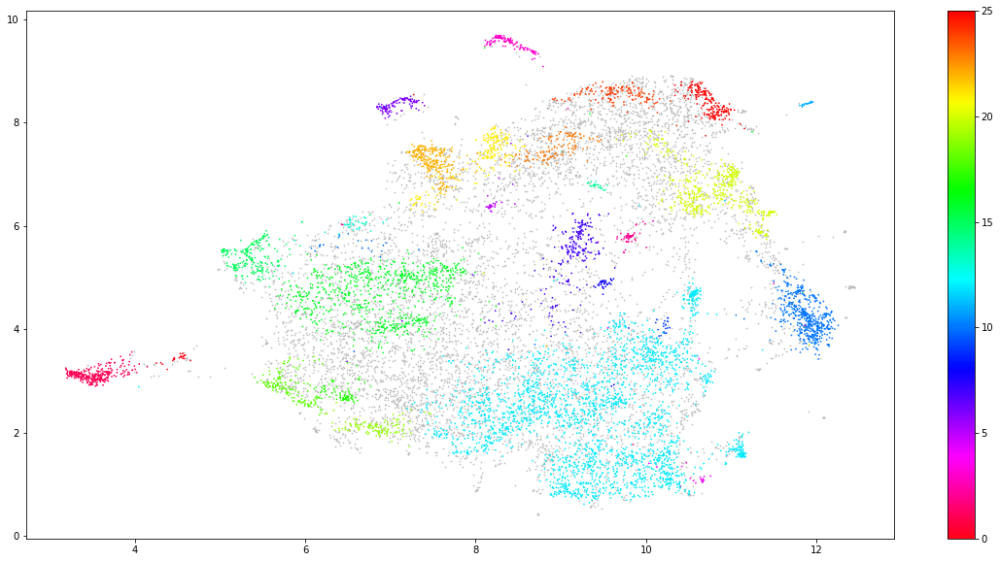

In [274]:
# Prepare data
umap_data = umap.UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.5)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.5, cmap='hsv_r')
plt.colorbar()

In [275]:
docs_df = pd.DataFrame(data, columns=["Doc"])
docs_df['Topic'] = cluster.labels_
docs_df['Doc_ID'] = range(len(docs_df))
docs_per_topic = docs_df.groupby(['Topic'], as_index = False).agg({'Doc': ' '.join})

In [276]:
def c_tf_idf(documents, m, ngram_range=(1, 1)):
    count = CountVectorizer(ngram_range=ngram_range, stop_words="english").fit(documents)
    t = count.transform(documents).toarray()
    w = t.sum(axis=1)
    tf = np.divide(t.T, w)
    sum_t = t.sum(axis=0)
    idf = np.log(np.divide(m, sum_t)).reshape(-1, 1)
    tf_idf = np.multiply(tf, idf)

    return tf_idf, count
  
tf_idf, count = c_tf_idf(docs_per_topic.Doc.values, m=len(data))

In [277]:
def extract_top_n_words_per_topic(tf_idf, count, docs_per_topic, n=20):
    words = count.get_feature_names()
    labels = list(docs_per_topic.Topic)
    tf_idf_transposed = tf_idf.T
    indices = tf_idf_transposed.argsort()[:, -n:]
    top_n_words = {label: [(words[j], tf_idf_transposed[i][j]) for j in indices[i]][::-1] for i, label in enumerate(labels)}
    return top_n_words

def extract_topic_sizes(df):
    topic_sizes = (df.groupby(['Topic'])
                     .Doc
                     .count()
                     .reset_index()
                     .rename({"Topic": "Topic", "Doc": "Size"}, axis='columns')
                     .sort_values("Size", ascending=False))
    return topic_sizes

top_n_words = extract_top_n_words_per_topic(tf_idf, count, docs_per_topic, n=20)
topic_sizes = extract_topic_sizes(docs_df);
top_topics = topic_sizes[topic_sizes['Topic']!=-1]
top_topics.shape

(26, 2)

In [278]:
topics = top_topics['Topic'].values

In [279]:
for topic in topics:
    print(topic)
    print(pd.DataFrame(top_n_words[topic]))
    print('\n')

12
              0         1
0        health  0.019920
1     isolation  0.019521
2   individuals  0.017084
3      measures  0.016957
4       control  0.016708
5   quarantined  0.016553
6        public  0.016204
7       disease  0.015871
8         model  0.014961
9      patients  0.014949
10      contact  0.014949
11   infectious  0.014538
12     infected  0.014199
13   quarantine  0.013470
14        cases  0.013160
15         home  0.012442
16    infection  0.012092
17      exposed  0.011380
18         rate  0.011328
19         time  0.011079


16
                0         1
0          health  0.019132
1            fear  0.018721
2        measures  0.017372
3          public  0.016275
4         disease  0.015925
5       isolation  0.015742
6       difficult  0.015192
7            lack  0.014828
8            care  0.014139
9        patients  0.014021
10         people  0.013984
11        control  0.013565
12    quarantined  0.013005
13           sars  0.011849
14       outbreak  0.01107

### Manually create topic labels 

In [497]:
# Names for each topic were manually created by looking through examples in each topic and the most relevant words
topic_labels_dict = {
 12: 'quarantine measures',
 16: 'lockdown & quarantine consequences',
 10: 'animals',
 20: 'quarantine length',
 1:  'cellular shutdown',
 22: 'china',
 7:  'historical quarantines',
 15: 'studies on quarantined individuals',
 21: 'wuhan',
 25: 'other epidemics',
 18: 'lockdown effect on transmission rate',
 24: 'quantative metrics',
 3: 'korea',
 23: 'early 2020',
 19: 'lockdown reducing infections',
 6: 'canada',
 17: 'increasing cases',
 2: 'australia',
 8: 'sars',
 13: 'authorities',
 11: 'copyright',
 0: 'electrical systems',
 5: 'cities in lockdown',
 14: 'japan',
 4: 'links',
 9: 'thermoscanners',
 -1: 'outliers'
}

### Plot topic labels

In [498]:
def get_centroid(arr):
    length = arr.shape[0]
    sum_x = np.sum(arr[:, 0])
    sum_y = np.sum(arr[:, 1])
    x_centre, y_centre = sum_x/length, sum_y/length
    return x_centre, y_centre

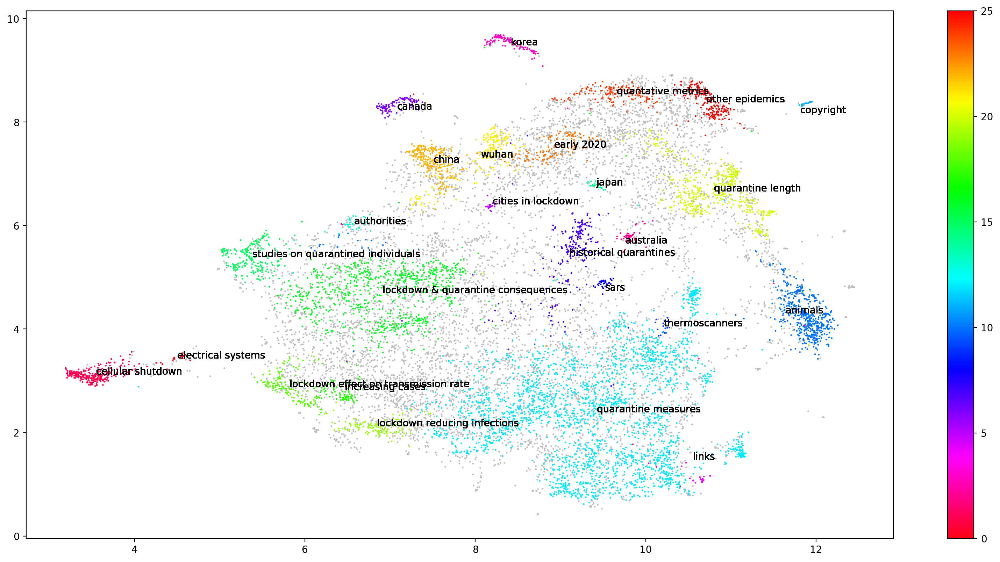

In [499]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10), dpi=200)
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.5)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.5, cmap='hsv_r')
plt.colorbar()

# Plot topic names
for label in result['labels']:
    # skip outliers
    if label == -1:
        pass
    else:
        label_name = topic_labels_dict[label]
        coords = result[result['labels']==label][['x', 'y']].values
        x_pos, y_pos = get_centroid(coords)
        plt.text(x_pos, y_pos, label_name)

## 6. Topic Example Sentences & Papers <a class="anchor" id="topic-examples"></a>

In [523]:
def get_article_info(topic):
    """
    Retrieves examples for a given topic number and returns article information.
    """
    
    # Example sentence
    examples = docs_df[docs_df['Topic']==topic].sample(20, random_state=1)['Doc'].values
    for example in examples:
        
        try:

            example_paper_id = sentence2paper[example]

            example_title = corpus_df[corpus_df['paper_id']==example_paper_id]['title'].values[0]

            example_abstract = corpus_df[corpus_df['paper_id']==example_paper_id]['abstract'].values[0]
            
            example_link = metadata_df[metadata_df['sha']==example_paper_id]['url'].values[0]
            
            if (len(example_title) > 0) & (len(example_abstract) > 0):
                print('**SENTENCE**')
                print(example)
                print('\n')
                print('**TITLE**')
                print(example_title)
                print('\n')
                print('**ABSTRACT**')
                print(example_abstract)
                print('\n')
                print('**LINK**')
                print(example_link)
                print('\n\n\n')
            else:
                pass

        except:
            pass

### Topic 18: Lockdown effect on transmission rate

In [495]:
get_article_info(18)

**SENTENCE**
• After imposing a lockdown, the trajectory of the number of reported cases may show no outwardly visible change even if the lockdown has been well-timed and has significantly slowed the spread of the disease.


**TITLE**
Transmission Dynamics of COVID-19 and Impact on Public Health Policy


**ABSTRACT**
Abstract

In this work we construct a mathematical model for the transmission and spread of coronavirus disease 2019 or COVID-19. Our model features delay terms to account for (a) the time lapse or latency period between contracting the disease and displaying symptoms, and (b) the time lag in testing patients for the virus due to the limited numbers of testing facilities currently available. We find that the delay introduces a significant disparity between the actual and reported time-trajectories of cases in a particular region. Specifically, the reported case histories lag the actual histories by a few days. Hence, to minimize the spread of the disease, lockdowns and sim

**SENTENCE**
Less time in quarantine predicted less state anger ðb ¼ :14; p ¼ :008Þ.


**TITLE**
The relevance of psychosocial variables and working conditions in predicting nurses' coping strategies during the SARS crisis: An online questionnaire survey


**ABSTRACT**
Abstract

Objectives: The purpose of this investigation was to examine the relationship between psychosocial variables and working conditions, and nurses' coping methods and distress in response to the severe acute respiratory syndrome (SARS) crisis in Canada. Participants and procedure: The sample consisted of 333 nurses (315 women, 18 men) who completed an Internetmediated questionnaire that was posted on the Registered Nurses' Association of Ontario (RNAO) website between March and May 2004. The questionnaire was restricted to respondents who had to authenticate their RNAO membership with a valid username and password before accessing the questionnaire. This served a dual purpose: to ensure that only RNAO nurses compl

**SENTENCE**
The height of the peak in w with the lockdown in place (about 0.007) has also reduced drastically relative to that without the lockdown (Fig.


**TITLE**
Transmission Dynamics of COVID-19 and Impact on Public Health Policy


**ABSTRACT**
Abstract

In this work we construct a mathematical model for the transmission and spread of coronavirus disease 2019 or COVID-19. Our model features delay terms to account for (a) the time lapse or latency period between contracting the disease and displaying symptoms, and (b) the time lag in testing patients for the virus due to the limited numbers of testing facilities currently available. We find that the delay introduces a significant disparity between the actual and reported time-trajectories of cases in a particular region. Specifically, the reported case histories lag the actual histories by a few days. Hence, to minimize the spread of the disease, lockdowns and similarly drastic social isolation measures need to be imposed some tim

**SENTENCE**
Reducing the time scale to a matter of hours, which is now possible with molecular diagnosis, will provide us with a much easier way of managing crises.The remaining question is whether repeated negative test results are sufficient to shorten the quarantine period.


**TITLE**
Testing the repatriated for SARS-Cov2: Should laboratory-based quarantine replace traditional quarantine?


**ABSTRACT**
Abstract

Background: An ongoing epidemic of respiratory diseases caused by a novel coronavirus (COVID 2019, SARS-CoV2) started in Wuhan, Hubei, in China at the end of December 2019. The French government decided to repatriate the 337 French nationals living in Wuhan and place them in quarantine in their home country. We decided to test them all for SARS-Cov2 twice in order to reduce anxiety among the population and decisionmakers. Methods: We investigated the presence of SARS-CoV-19 in asymptomatic carriers by testing all repatriated patients within the first 24 h of their arrival

**SENTENCE**

After imposing a lockdown, the trajectory of the number of reported cases may show no outwardly visible change even if the lockdown has been well-timed and has significantly slowed the spread of the disease.


**TITLE**

Transmission Dynamics of COVID-19 and Impact on Public Health Policy


**ABSTRACT**

In this work we construct a mathematical model for the transmission and spread of coronavirus disease 2019 or COVID-19. Our model features delay terms to account for (a) the time lapse or latency period between contracting the disease and displaying symptoms, and (b) the time lag in testing patients for the virus due to the limited numbers of testing facilities currently available. We find that the delay introduces a significant disparity between the actual and reported time-trajectories of cases in a particular region. Specifically, the reported case histories lag the actual histories by a few days. Hence, to minimize the spread of the disease, lockdowns and similarly drastic social isolation measures need to be imposed some time before the reported figures are approaching their peak values. We then account for the social reality that lockdowns can only be of a limited duration in view of practical considerations. We find that the most effective interval for imposing such a limited-time lockdown is one where the midpoint of the lockdown period coincides with the actual peak of the spread of the disease in the absence of the lockdown. We further show that the true effectivity of imposing a lockdown may be misrepresented and grossly underestimated by the reported case trajectories in the days following the action.


**LINK**
https://doi.org/10.1101/2020.03.29.20047035

**SENTENCE**

Once the epidemic has passed through the low risk population, quarantine measures can be lowered in stages, with each stage exposing successively higher risk populations.


**TITLE**
The Effectiveness of Targeted Quarantine for Minimising Impact of COVID-19


**ABSTRACT**
Abstract

We model the extent to which age targeted quarantine can be used to reduce ICU admissions caused by novel coronavirus COVID-19. Using demographic data from New Zealand, we demonstrate that lowering the age threshold for quarantine to 50 years of age reduces ICU admissions drastically, and show that for sufficiently strict isolation protocols, isolating one third of the countries population for a total of 6 months is sufficient to avoid overwhelming ICU capacity throughout the entire course of the epidemic. Similar results are expected to hold for other countries, though some minor adaption will be required based on local age demographics and hospital facilities.. CC-BY 4.0 International license It is made available under a author/funder, who has granted medRxiv a license to display the preprint in perpetuity.is the (which was not peer-reviewed) The copyright holder for this preprint .


**LINK**
https://doi.org/10.1101/2020.04.01.20049692

**SENTENCE**
We introduced both the the quarantine factor and the traffic blockage factor, then the flow variable and transmission rate in the model will vary as the change of these two intervation factors, then the effectiveness of the traffic blockage and quarantine can be simulated and evaluated.In the simulated results, we conclude that if the masses take protective measures, the peak number of cases will decrease greatly by 89.68%.


**TITLE**
Estimating the Efficacy of Quarantine and Traffic Blockage for the Epidemic Caused by 2019-nCoV (COVID-19)：A Simulation Analysis


**ABSTRACT**
Abstract

Background: Since the 2019-nCoV outbreaks in Wuhan, China, the cumulative number of confirmed cases is increasing every day, and a large number of populations all over the world are at risk. The quarantine and traffic blockage can alleviate the risk of the epidemic and the infections, henceforth evaluating the efficacy of such actions is essential to inform policy makers and raise the public awareness of the importance of self-isolation and quarantine.We collected confirmed case data and the migration data, and introduced the quarantine factor and traffic blockage factor to the Flow-SEIR model. By varying the quarantine factor and traffic blockage factor, we simulated the change of the peak number and arrival time of infections, then the efficacy of these two intervation measures can be analyzed in our simulation. In our study, the self-protection at home is also included in quarantine.In the simulated results, the quarantine and traffic blockage are effective for epidemic control. For Hubei province, the current quarantine factor is estimaed to be 0.405, which means around 40.5% of suceptibles who are close contacting with are in quarantine, and the current traffic blockage factor is estimaed to be 0.66, which indicates around 34% of suceptibles who had flowed out from Hubei. For the other provinces outside Hubei, the current quarantine factor is estimated to be 0.285, and the current traffic blockage factor is estimated to be 0.26. With the quarantine and traffic blockage factor increasing, the number of infections decrease dramatically. We also simulated the start dates of quarantine and traffic blockage at four time points, the simulated results show that the early of warning is also effective for epidemic containing.However, provincial level traffic blockage can only alleviate 21.06% -22.38% of the peak number of infections. In general, the quarantine is much more effective than the traffic blockage control.




**LINK**
https://doi.org/10.1101/2020.02.14.20022913

### Topic 16: 'lockdown & quarantine consequences'

In [502]:
get_article_info(16)

**SENTENCE**
[4] [5] [6] [7] Greater distress was associated with quarantine, 8 treating colleagues with SARS, 9 fear of contagion, 7,10,11 concern for family health, 6,11,12 job stress, 7,11 interpersonal isolation, 7,11 and perceived stigma.


**TITLE**
Applying the Lessons of SARS to Pandemic Influenza An Evidence-based Approach to Mitigating the Stress Experienced by Healthcare Workers


**ABSTRACT**
Abstract

We describe an evidence-based approach to enhancing the resilience of healthcare workers in preparation for an influenza pandemic, based on evidence about the stress associated with working in healthcare during the SARS outbreak. SARS was associated with significant long-term stress in healthcare workers, but not with increased mental illness. Reducing pandemic-related stress may best be accomplished through interventions designed to enhance resilience in psychologically healthy people. Applicable models to improve adaptation in individuals include Folkman and Greer's framewo

**SENTENCE**
The main cost of school closure is because of absenteeism of working parents who have to stay home to take care of their children.


**TITLE**
Review Closure of schools during an infl uenza pandemic


**ABSTRACT**
Abstract

In response to WHO raising the infl uenza pandemic alert level from phase fi ve to phase six, health offi cials around the world are carefully reviewing pandemic mitigation protocols. School closure (also called class dismissal in North America) is a non-pharmaceutical intervention that is commonly suggested for mitigating infl uenza pandemics. Health offi cials taking the decision to close schools must weigh the potential health benefi ts of reducing transmission and thus case numbers against high economic and social costs, diffi cult ethical issues, and the possible disruption of key services such as health care. Also, if schools are expected to close as a deliberate policy option, or just because of high levels of staff absenteeism, it is important t

**SENTENCE**
Furthermore, with the high rate of transmission of SARS to health care workers; fear, staff quarantine, SARS development, and emotional stress further limited the supply of critical care staff.


**TITLE**
Communication in the Toronto critical care community: important lessons learned during SARS


**ABSTRACT**
Abstract

The SARS outbreak in 2003 pushed Toronto's health care system to its limits. Staffing shortages, transmission of SARS within the ICU, and the influx of critically ill SARS patients were some unique challenges to the delivery of critical care. Communication strategies were a key component in the critical care response to SARS. Regular teleconference calls, web-based training and education, and the rapid coordination of research studies were some of the initiatives developed within the Toronto critical care community during the SARS outbreak. Other critical care communities should consider their communication strategies in advance of similar events.




**LI

**SENTENCE**
Like other quarantined persons in relevant studies, [14] [15] [16] 21 some participants perceived risk, felt doubt, and were reluctant to accept being quarantined owing to insufficient or inadequate information about SARS and quarantine policy.


**TITLE**
Lessons learned from the anti-SARS quarantine experience in a hospital- based fever screening station in Taiwan


**ABSTRACT**
Abstract

Background: Severe acute respiratory syndrome (SARS) was the first major novel infectious disease to hit the international community in the 21st century. While SARS was sweeping over almost 30 countries, most hospitals in Taiwan instituted mandatory quarantine measures, one of the most effective public health strategies for preventing disease transmission. We explored the anti-SARS quarantine experience of patients in a hospital-based fever screening station. Methods: We conducted a phenomenologic, qualitative study using semistructured telephone interviews during the SARS outbreak in T

**SENTENCE**
Therefore, it has to continually receive and maintain several small groups of poultry of different ages, and even with quarantine precautions, it is unlikely that eradication will be feasible, as an all-in all-out system will never be practical with the current housing facilities.The extreme variability and low VI of at least three groups of birds sampled would suggest that improvements could be made in the effectiveness of the NDV vaccine administration or problems with the vaccines themselves.


**TITLE**
Detection of infectious bronchitis virus 793B, avian metapneumovirus, Mycoplasma gallisepticum and Mycoplasma synoviae in poultry in Ethiopia


**ABSTRACT**
Abstract

A survey was conducted into respiratory infectious diseases of poultry on a chicken breeder farm run by the Ethiopian Institute of Agricultural Research (EIAR), located in Debre Zeit, Ethiopia. Oropharyngeal swabs were collected from 117 randomly selected birds, and blood was taken from a subset of 73 of t

**SENTENCE**
This represents non-compliance with IATA guidance and a potential criminal breach of US health and quarantine laws.


**TITLE**
Personal View Guidelines, law, and governance: disconnects in the global control of airline-associated infectious diseases


**ABSTRACT**
Abstract

International air travel is increasingly affecting the epidemiology of infectious diseases. A particular public health, economic, and political concern is the role of air travel in bringing infectious passengers or vectors to previously non-endemic areas. Yet, little research has been done to investigate either the infection risks associated with air travel or the empirical evidence for the effectiveness of infection control measures on aircraft and at borders. We briefly review the interface between international and national legislation, policy, and guidelines in the context of existing infection risks and possible scenarios. We have found that public health guidance and legislation, which airlines a

**SENTENCE**
In the same study, quarantined staff were significantly more likely to report exhaustion, detachment from others, anxiety when dealing with febrile patients, irritability, insomnia, poor concentration and indecisiveness, deteri orating work performance, and reluctance to work or consid eration of resignation.


**TITLE**
Rapid Review The psychological impact of quarantine and how to reduce it: rapid review of the evidence


**ABSTRACT**
Abstract

The December, 2019 coronavirus disease outbreak has seen many countries ask people who have potentially come into contact with the infection to isolate themselves at home or in a dedicated quarantine facility. Decisions on how to apply quarantine should be based on the best available evidence. We did a Review of the psychological impact of quarantine using three electronic databases. Of 3166 papers found, 24 are included in this Review. Most reviewed studies reported negative psychological effects including post-traumatic stress s

**SENTENCE**
Healthcare workers themselves are often quarantined and this Review suggests they, like the general public, are negatively affected by stigmatising attitudes from others.


**TITLE**
Rapid Review The psychological impact of quarantine and how to reduce it: rapid review of the evidence


**ABSTRACT**
Abstract

The December, 2019 coronavirus disease outbreak has seen many countries ask people who have potentially come into contact with the infection to isolate themselves at home or in a dedicated quarantine facility. Decisions on how to apply quarantine should be based on the best available evidence. We did a Review of the psychological impact of quarantine using three electronic databases. Of 3166 papers found, 24 are included in this Review. Most reviewed studies reported negative psychological effects including post-traumatic stress symptoms, confusion, and anger. Stressors included longer quarantine duration, infection fears, frustration, boredom, inadequate supplies, inadequate information, financial loss, and stigma. Some researchers have suggested long-lasting effects. In situations where quarantine is deemed necessary, officials should quarantine individuals for no longer than required, provide clear rationale for quarantine and information about protocols, and ensure sufficient supplies are provided. Appeals to altruism by reminding the public about the benefits of quarantine to wider society can be favourable.

**LINK**
https://doi.org/10.1016/s0140-6736(20)30460-8; https://www.ncbi.nlm.nih.gov/pubmed/32112714/; https://api.elsevier.com/content/article/pii/S0140673620304608; https://www.sciencedirect.com/science/article/pii/S0140673620304608

**SENTENCE**
In the same study, quarantined staff were significantly more likely to report exhaustion, detachment from others, anxiety when dealing with febrile patients, irritability, insomnia, poor concentration and indecisiveness, deteri orating work performance, and reluctance to work or consid eration of resignation.


**TITLE**
Rapid Review The psychological impact of quarantine and how to reduce it: rapid review of the evidence


**ABSTRACT**
Abstract

The December, 2019 coronavirus disease outbreak has seen many countries ask people who have potentially come into contact with the infection to isolate themselves at home or in a dedicated quarantine facility. Decisions on how to apply quarantine should be based on the best available evidence. We did a Review of the psychological impact of quarantine using three electronic databases. Of 3166 papers found, 24 are included in this Review. Most reviewed studies reported negative psychological effects including post-traumatic stress symptoms, confusion, and anger. Stressors included longer quarantine duration, infection fears, frustration, boredom, inadequate supplies, inadequate information, financial loss, and stigma. Some researchers have suggested long-lasting effects. In situations where quarantine is deemed necessary, officials should quarantine individuals for no longer than required, provide clear rationale for quarantine and information about protocols, and ensure sufficient supplies are provided. Appeals to altruism by reminding the public about the benefits of quarantine to wider society can be favourable.




**LINK**
https://doi.org/10.1016/s0140-6736(20)30460-8; https://www.ncbi.nlm.nih.gov/pubmed/32112714/; https://api.elsevier.com/content/article/pii/S0140673620304608; https://www.sciencedirect.com/science/article/pii/S0140673620304608

**SENTENCE**
Of the working conditions variables, greater spent time in quarantine was predictive of higher levels of avoidance behavior, and state anger, whereas greater contact with SARS patients was only predictive of greater emotional exhaustion.


**TITLE**
The relevance of psychosocial variables and working conditions in predicting nurses' coping strategies during the SARS crisis: An online questionnaire survey


**ABSTRACT**
Abstract

Objectives: The purpose of this investigation was to examine the relationship between psychosocial variables and working conditions, and nurses' coping methods and distress in response to the severe acute respiratory syndrome (SARS) crisis in Canada. Participants and procedure: The sample consisted of 333 nurses (315 women, 18 men) who completed an Internetmediated questionnaire that was posted on the Registered Nurses' Association of Ontario (RNAO) website between March and May 2004. The questionnaire was restricted to respondents who had to authenticate their RNAO membership with a valid username and password before accessing the questionnaire. This served a dual purpose: to ensure that only RNAO nurses completed the questionnaire and thereby safeguarding the generalizability of the findings; and second, to prevent any one nurse from contributing more than once to the overall sample. Results: Correlational analysis yielded several significant relationships between psychosocial variables and working conditions, and the traditional correlates of burnout and stress. Three multiple regression analysis revealed that the model we evolved-including higher levels of vigor, organizational support, and trust in equipment/infection control initiative; and lower levels of contact with SARS patients, and time spent in quarantine-predicted to lower levels of avoidance behavior, emotional exhaustion, and state anger. Conclusions: By employing models of stress and burnout that combine psychosocial variables and working conditions, researchers can account for significant amounts of variance in outcomes related to burnout. These findings highlight the importance of vigor and perceived organizational support in predicting nurses' symptoms of burnout. For healthcare administrators, this means that a likely strategy for assuaging the negative outcomes of stress should address nurses' psychosocial concerns and the working conditions that they face during novel times of crisis. rWhat is already known about the topic?Potential exposure to SARS contagion is related to nurses experiencing greater fear, uncertainty, and stress in the workplace.www.elsevier.com/locate/ijnurstu 0020-7489/$ -see front matter r (E.R. Greenglass).Perceived organizational support and vigor are negatively related to stress and burnout in nurses.A model that predicts to symptoms of burnout in nurses by combining psychosocial variables and working conditions as predictors.A tenable procedure for using an Internet-mediated questionnaire that counterbalances the main disadvantages of Internet research.




**LINK**
https://api.elsevier.com/content/article/pii/S0020748906000745; https://www.sciencedirect.com/science/article/pii/S0020748906000745; https://www.ncbi.nlm.nih.gov/pubmed/16618485/


**SENTENCE**
Other concerns involved the worldwide public panic, with its emotional and psychological tolls; the social instability that occurred in the hardest hit areas; the loss of jobs by some government officials; the closures of hospitals, schools, and borders; and even the deployment in Singapore of military forces to assist in contact tracing and enforcement of quarantines.


**TITLE**
Special Article Severe Acute Respiratory Syndrome (SARS): A Review of the History, Epidemiology, Prevention, and Concerns for the Future


**ABSTRACT**
Abstract

During the first part of 2003, the world experienced the first epidemic of the 21st century with the emergence of a new and readily transmissible disease. The disease, severe acute respiratory syndrome (SARS), spread quickly and caused numerous deaths, as well as public panic. This article provides a brief review of the initial history of the epidemiology, as well as of the clinical definition, occurrence in the pediatric population, etiology, prevention, drug studies, and considerations for the future.




**LINK**
https://www.ncbi.nlm.nih.gov/pubmed/12913837/; https://api.elsevier.com/content/article/pii/S1045187003000566; https://www.sciencedirect.com/science/article/pii/S1045187003000566

### Topic 5: 'cities in lockdown'

In [521]:
# Example sentence
get_article_info(5)

**SENTENCE**
As both city and week fixed effects are included in the regression, the coefficient 2 estimates the difference in air pollution between the treated (locked-down) cities and the control cities before and after the enforcement of the lockdown policy.


**TITLE**
COVID-19, City Lockdown, and Air Pollution: Evidence from China


**ABSTRACT**
Abstract

The rapid spread of COVID-19 is a global public health challenge. To prevent the escalation of its transmission, China locked down one-third of its cities and strictly restricted human mobility and economic activities. Using timely and comprehensive air quality data in China, we show that these counter-COVID-19 measures led to remarkable improvement in air quality. Within weeks, the Air Quality Index and PM2.5 concentrations were brought down by 25%. The effects are larger in colder, richer, and more industrialized cities. We estimate that such improvement would avert 24,000 to 36,000 premature deaths from air pollution on a mont

**SENTENCE**
As both city and week fixed effects are included in the regression, the coefficient 2 estimates the difference in air pollution between the treated (locked-down) cities and the control cities before and after the enforcement of the lockdown policy.


**TITLE**
COVID-19, City Lockdown, and Air Pollution: Evidence from China


**ABSTRACT**
Abstract

The rapid spread of COVID-19 is a global public health challenge. To prevent the escalation of its transmission, China locked down one-third of its cities and strictly restricted human mobility and economic activities. Using timely and comprehensive air quality data in China, we show that these counter-COVID-19 measures led to remarkable improvement in air quality. Within weeks, the Air Quality Index and PM2.5 concentrations were brought down by 25%. The effects are larger in colder, richer, and more industrialized cities. We estimate that such improvement would avert 24,000 to 36,000 premature deaths from air pollution on a monthly basis. : medRxiv preprint Notes: Each column summarizes the mean values and standard deviations of each variable at a weekly level. More information about the dataset is described in Appendix 1.



**SENTENCE**
Figure 2 shows differences in the ratios of individuals in the five states in the core locked down cities and the ratios of infected users in each city.


**TITLE**
Impact of city and residential unit lockdowns on prevention and control of COVID-19


**ABSTRACT**
Abstract

With respect to the asymptomatic transmission characteristics of the novel coronavirus that appeared in 2019 (COVID-19), a susceptible-asymptomatic-infected-recovered-death (SAIRD) model that considered human mobility was constructed in this study. The dissemination of COVID-19 was simulated using computational experiments to identify the mechanisms underlying the impact of city and residential lockdowns on controlling the spread of the epidemic. Results: The implementation of measures to lock down cities led to higher mortality rates in these cities, due to reduced mobility. Moreover, implementing city lockdown along with addition of hospital beds led to improved cure and reduced mortality rates. Stringent implementation and early lockdown of residential units effectively controlled the spread of the epidemic, and reduced the number of hospital bed requirements. Collectively, measures to lock down cities and residential units should be taken to prevent the spread of COVID-19. In addition, medical resources should be increased in cities under lockdown. Implementation of these measures would reduce the spread of the virus to other cities and allow appropriate treatment of patients in cities under lockdown.

### Topic 24: 'quantative metrics'

In [525]:
# Example sentence
get_article_info(24)

**SENTENCE**
The estimated quarantine rate is 0.6185, much higher than that of 0.3917 estimated based on stage Ⅱ data.


**TITLE**
Modeling the Epidemic Dynamics and Control of COVID-19 Outbreak in China


**ABSTRACT**
Abstract

and more than 30 countries over last two months. COVID-19 has multiple characteristics distinct from other infectious diseases, including high infectivity during incubation, time delay between real dynamics and daily observed number of confirmed cases, and the intervention effects of implemented quarantine and control measures.We develop a Susceptible, Un-quanrantined infected, Quarantined infected, Confirmed infected (SUQC) model to characterize the dynamics of COVID-19 and explicitly parameterize the intervention effects of control measures, which is more suitable for analysis than other existing epidemic models.




**LINK**
https://doi.org/10.1101/2020.02.27.20028639




**SENTENCE**
In more detail, our analysis shows that increasing quarantine rate, q, by 

**SENTENCE**
/2020 Scenario (v) shows the result for the combined policies, assuming that only 50 percent of the population respect the shelter-in-place policy, while testing and identification process intensify by 10 folds.


**TITLE**
Modeling of COVID-19 Pandemic and Scenarios for Containment *


**ABSTRACT**
Abstract

The impact of COVID-19 pandemic on the global health and world's economy have been profound and unseen since the Spanish flu of 1918-19. As of now, many countries have been severely affected, partly because of slow responses to the crisis, ill-preparedness of their health system, and the fragile health infrastructure and the shortage of protective equipment. This note evaluates various scenarios, based on an estimation of number of identified and unidentified infected cases, and examines the effectiveness of different policy responses to contain this pandemic. Our result, based on an estimation of the model for Iran, show that in many instances the number of unidentified cases, including asymptomatic individuals, could be much bigger than the reported numbers. The results confirm that in such circumstances, social distancing alone cannot be an effective policy unless a large portion of the population confine themselves for an extended period of time, which is not only difficult to implement, but it could also prove extremely costly and damaging to the economy. An alternative policy, this note argues, is to couple effective social distancing with extensive testing, even to those who are asymptomatic, and isolate the identified cases actively. Otherwise, many lives will be lost, and the health system will collapse, adding to the ongoing economic troubles that many countries have started to encounter.JEL classification: I10, I18, I19.

**LINK**
https://doi.org/10.1101/2020.03.27.20045849

**SENTENCE**
In more detail, our analysis shows that increasing quarantine rate, q, by 10 or 20 times will bring forward the peak by 6.5 or 9 days, and lead to a reduction of the peak value in terms of the number of infected individuals by 87% or 93%.


**TITLE**
Clinical Medicine Estimation of the Transmission Risk of the 2019-nCoV and Its Implication for Public Health Interventions


**ABSTRACT**
Abstract

Since the emergence of the first cases in Wuhan, China, the novel coronavirus (2019-nCoV) infection has been quickly spreading out to other provinces and neighboring countries. Estimation of the basic reproduction number by means of mathematical modeling can be helpful for determining the potential and severity of an outbreak and providing critical information for identifying the type of disease interventions and intensity. A deterministic compartmental model was devised based on the clinical progression of the disease, epidemiological status of the individuals, and intervention measures. The estimations based on likelihood and model analysis show that the control reproduction number may be as high as 6.47 (95% CI 5.71-7.23). Sensitivity analyses show that interventions, such as intensive contact tracing followed by quarantine and isolation, can effectively reduce the control reproduction number and transmission risk, with the effect of travel restriction adopted by Wuhan on 2019-nCoV infection in Beijing being almost equivalent to increasing quarantine by a 100 thousand baseline value. It is essential to assess how the expensive, resource-intensive measures implemented by the Chinese authorities can contribute to the prevention and control of the 2019-nCoV infection, and how long they should be maintained. Under the most restrictive measures, the outbreak is expected to peak within two weeks (since 23 January 2020) with a significant low peak value. With travel restriction (no imported exposed individuals to Beijing), the number of infected individuals in seven days will decrease by 91.14% in Beijing, compared with the scenario of no travel restriction.


**LINK**
https://doi.org/10.3390/jcm9020462; https://www.ncbi.nlm.nih.gov/pubmed/32046137/

## 7. Generate Topic Word Clouds <a class="anchor" id="word-clouds"></a>

In [575]:
# Define a function to plot word cloud
def plot_cloud(wordcloud):
    # Set figure size
    plt.figure(figsize=(40, 30))
    # Display image
    plt.imshow(wordcloud) 
    # No axis details
    plt.axis("off")
    plt.show()

Topic Number 12
Topic Label quarantine measures


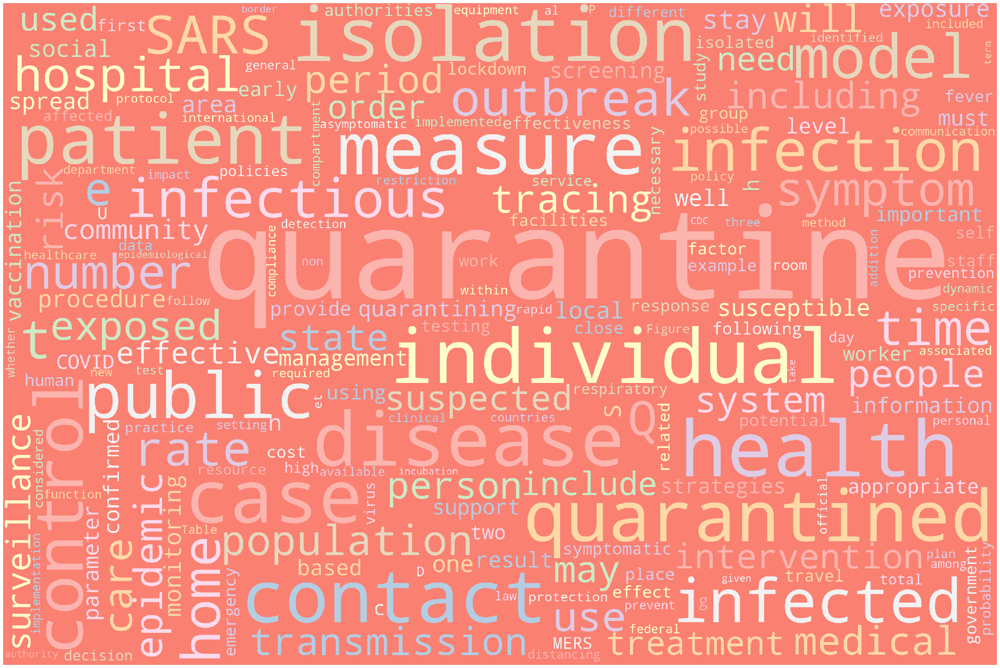

Topic Number 16
Topic Label lockdown & quarantine consequences


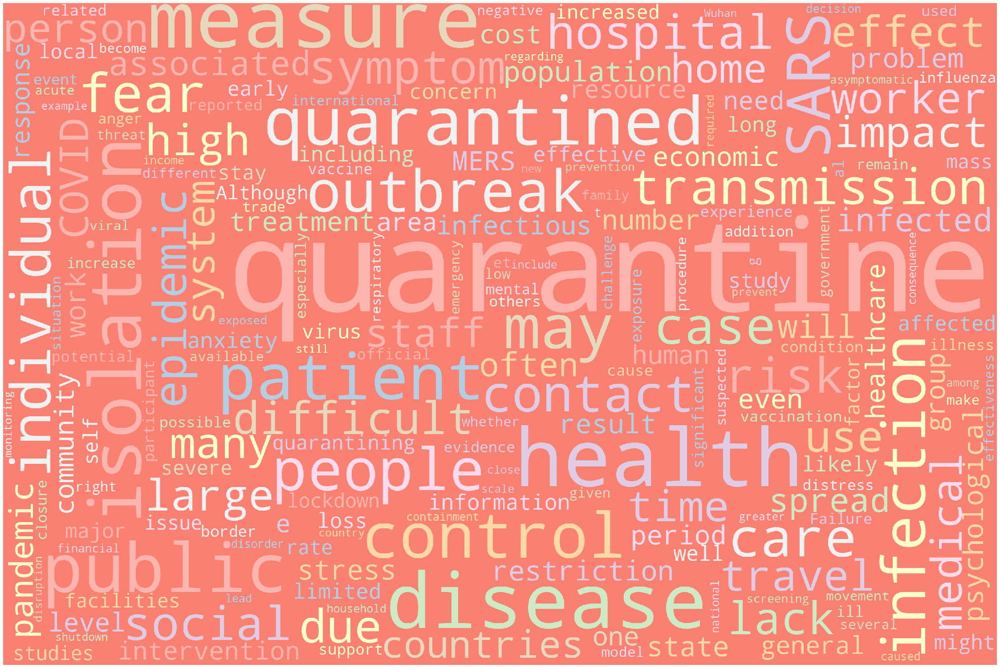

Topic Number 10
Topic Label animals


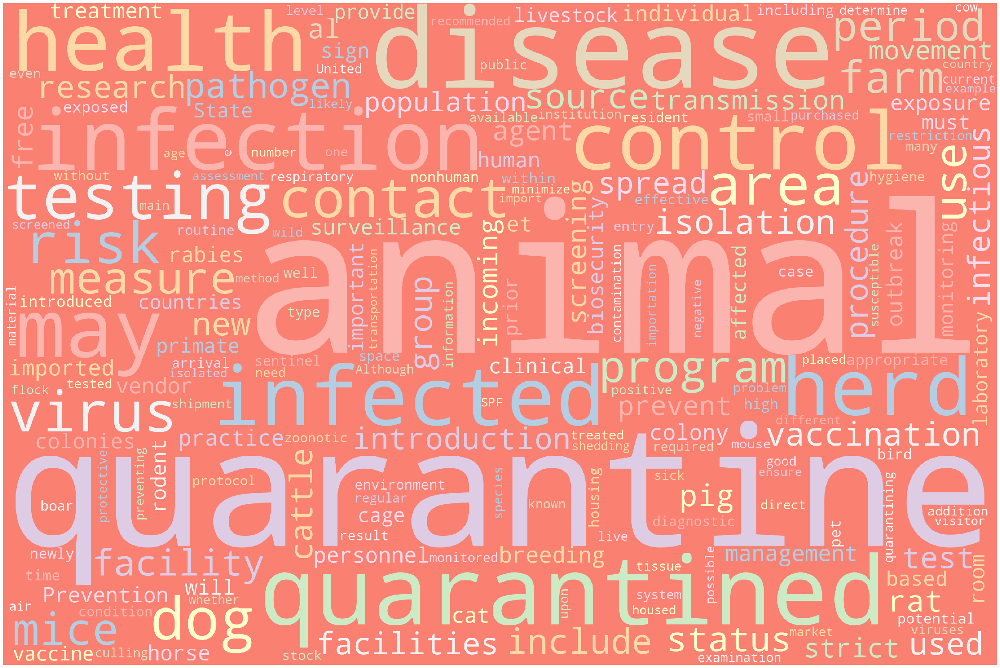

Topic Number 20
Topic Label quarantine length


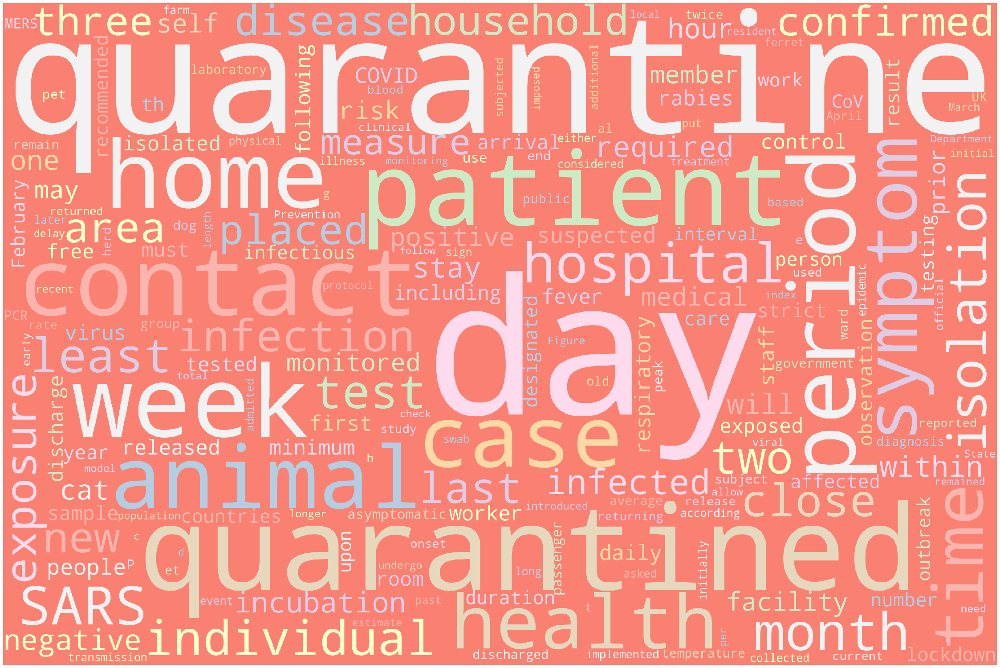

Topic Number 1
Topic Label cellular shutdown


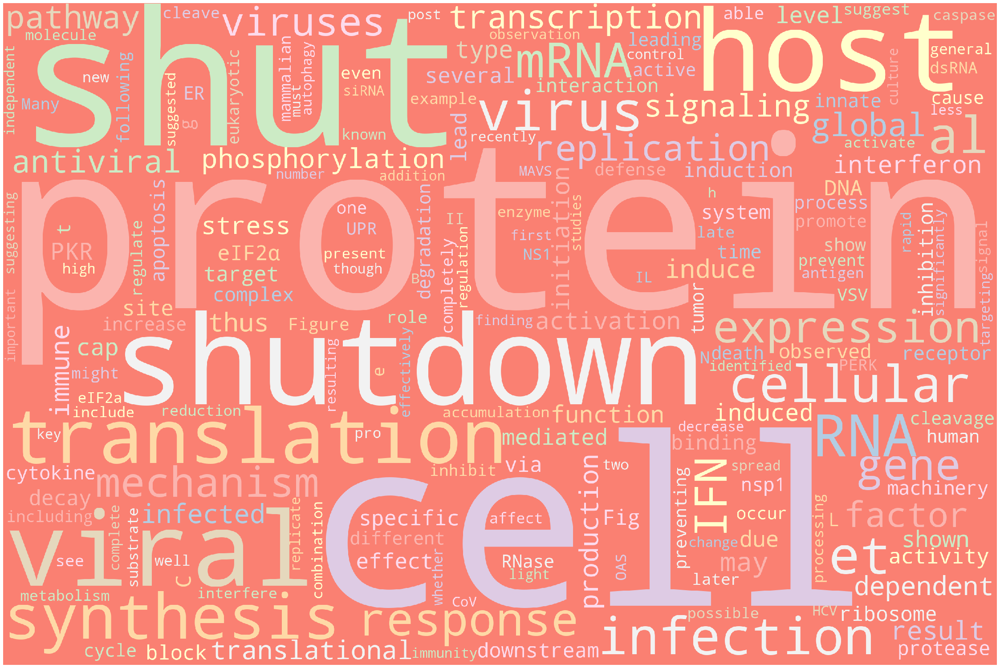

Topic Number 22
Topic Label china


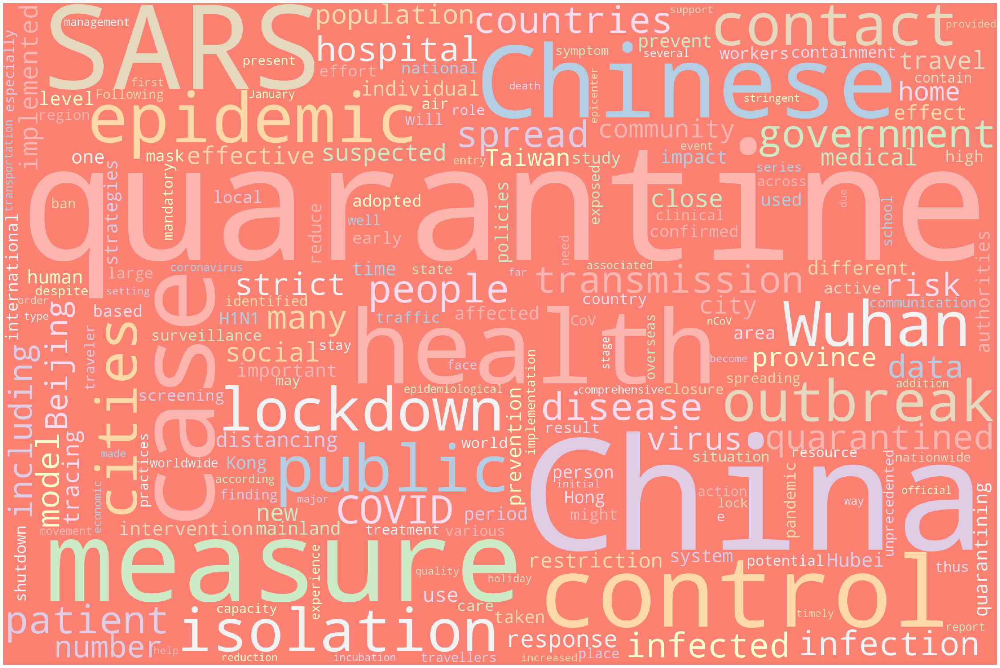

Topic Number 7
Topic Label historical quarantines


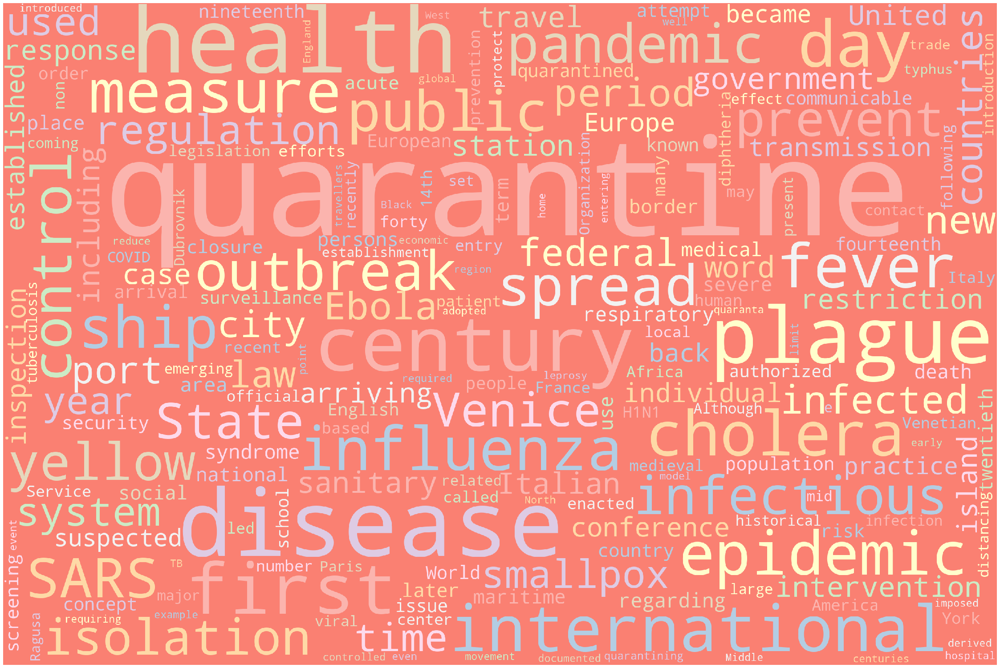

Topic Number 15
Topic Label studies on quarantined individuals


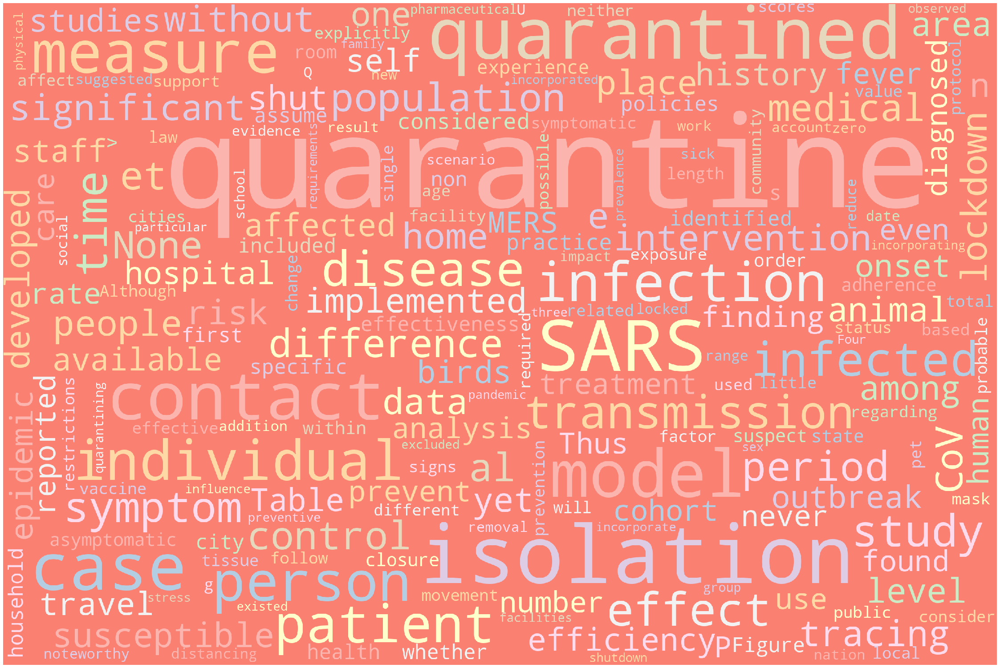

Topic Number 21
Topic Label wuhan


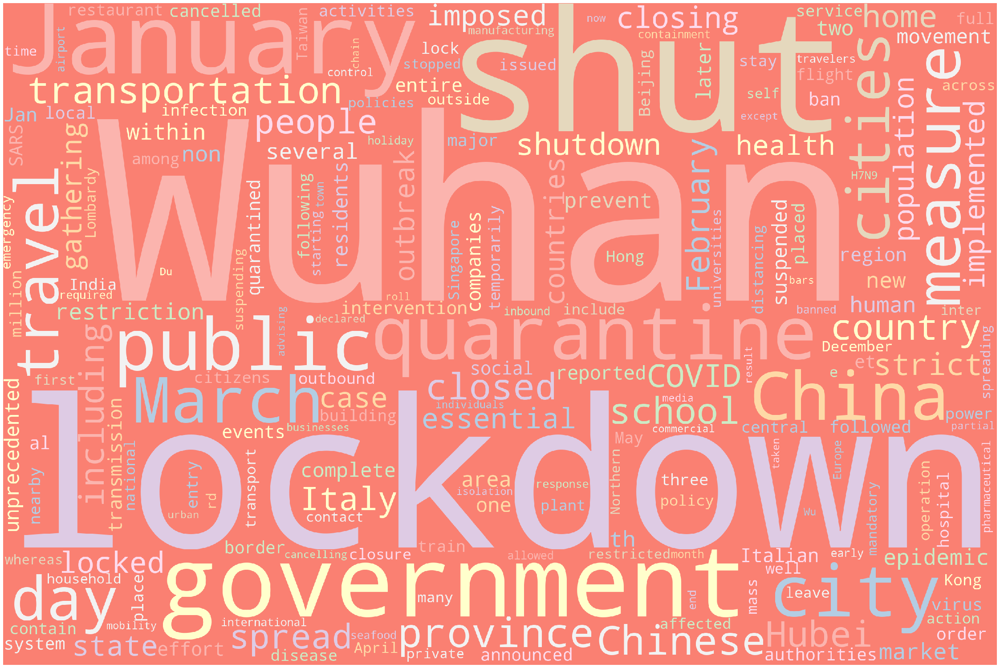

Topic Number 25
Topic Label other epidemics


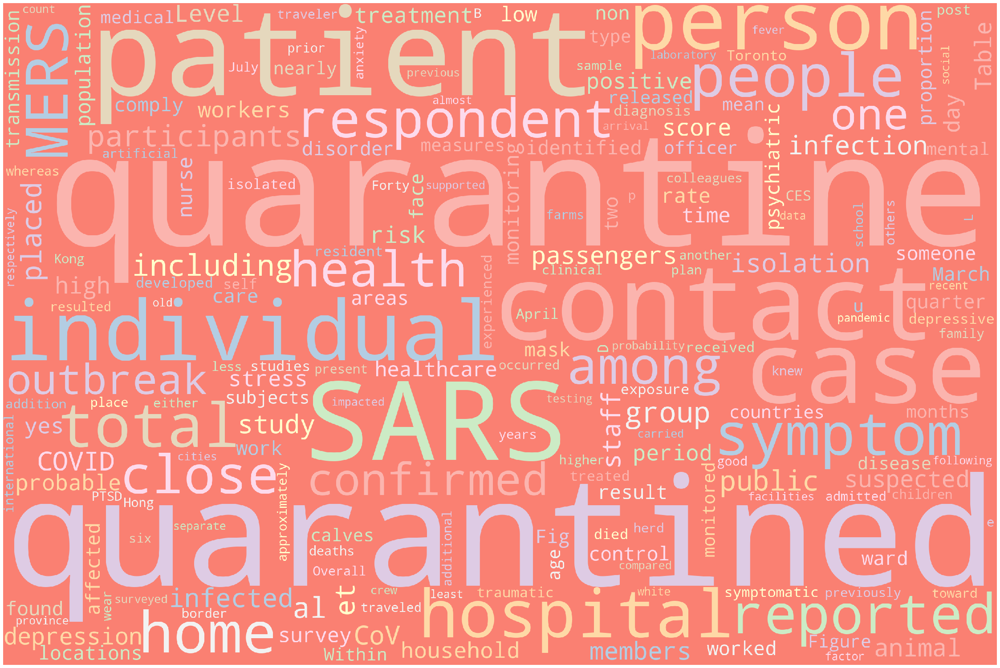

Topic Number 18
Topic Label lockdown effect on transmission rate


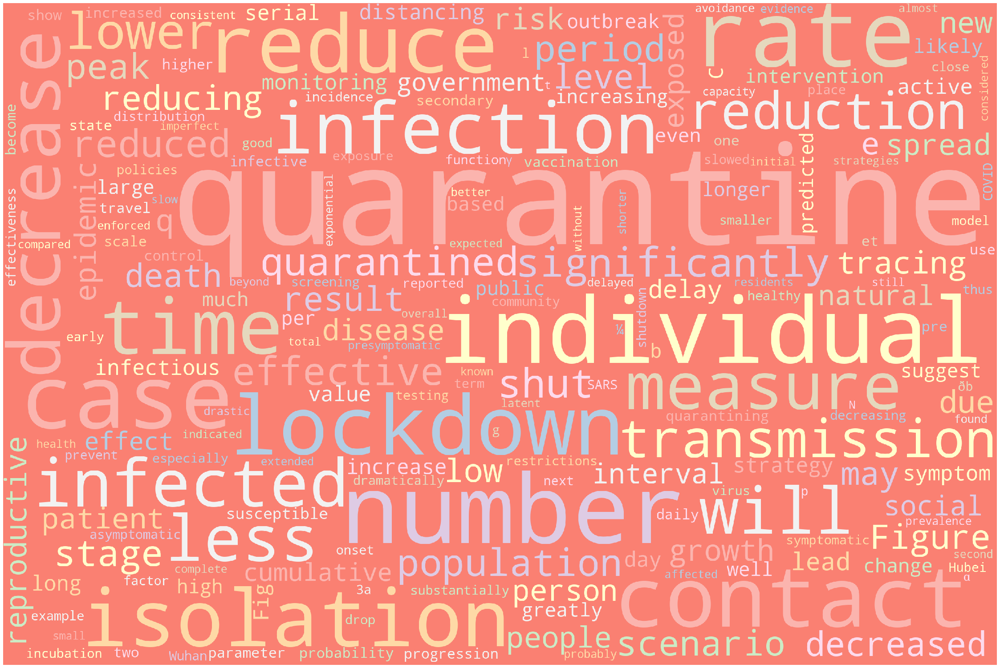

Topic Number 24
Topic Label quantative metrics


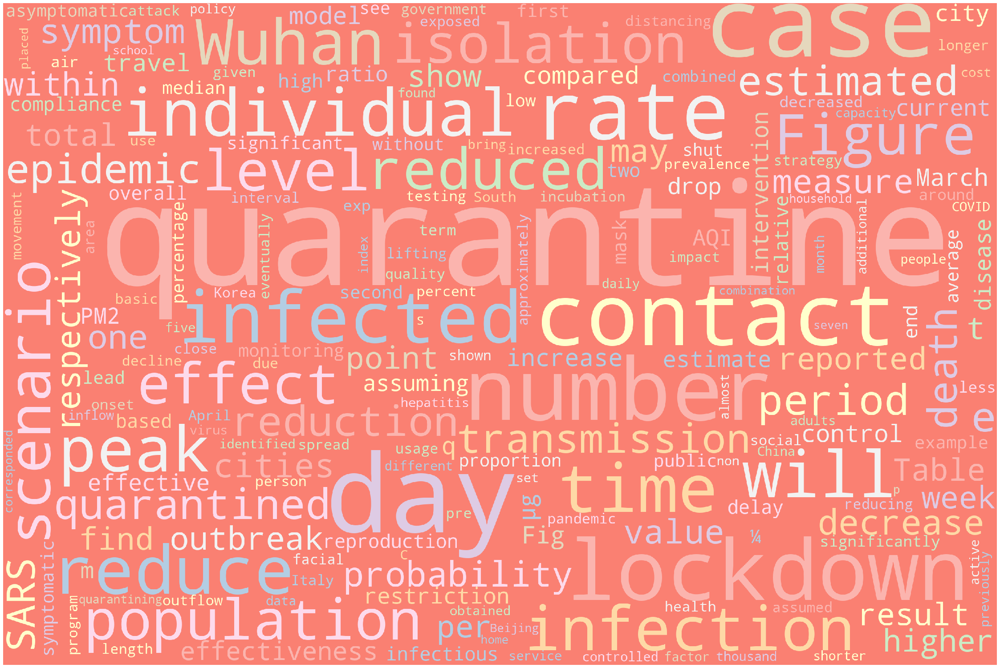

Topic Number 3
Topic Label korea


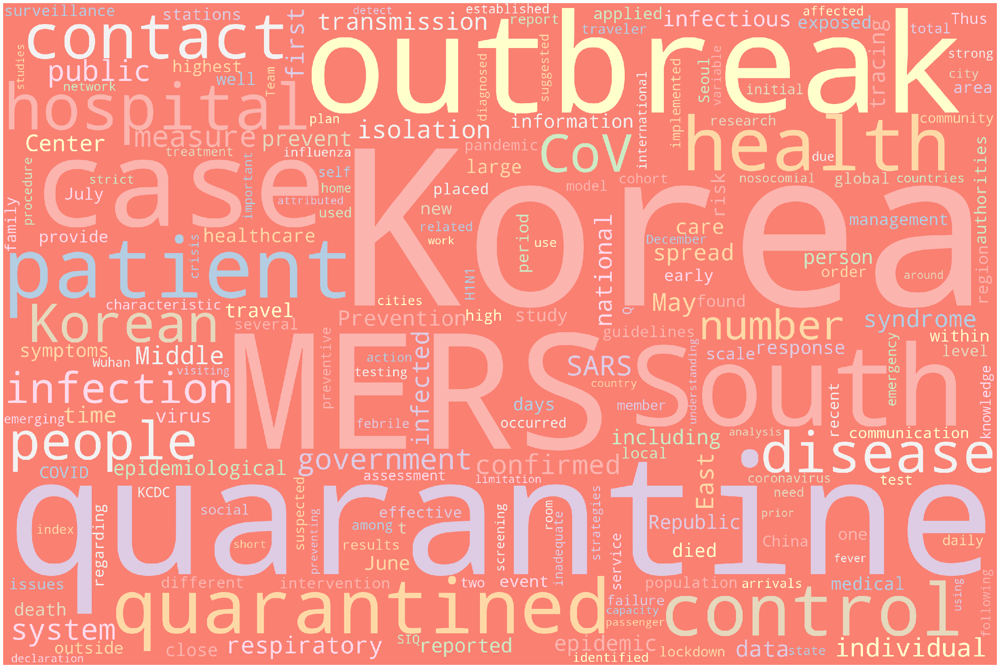

Topic Number 23
Topic Label early 2020


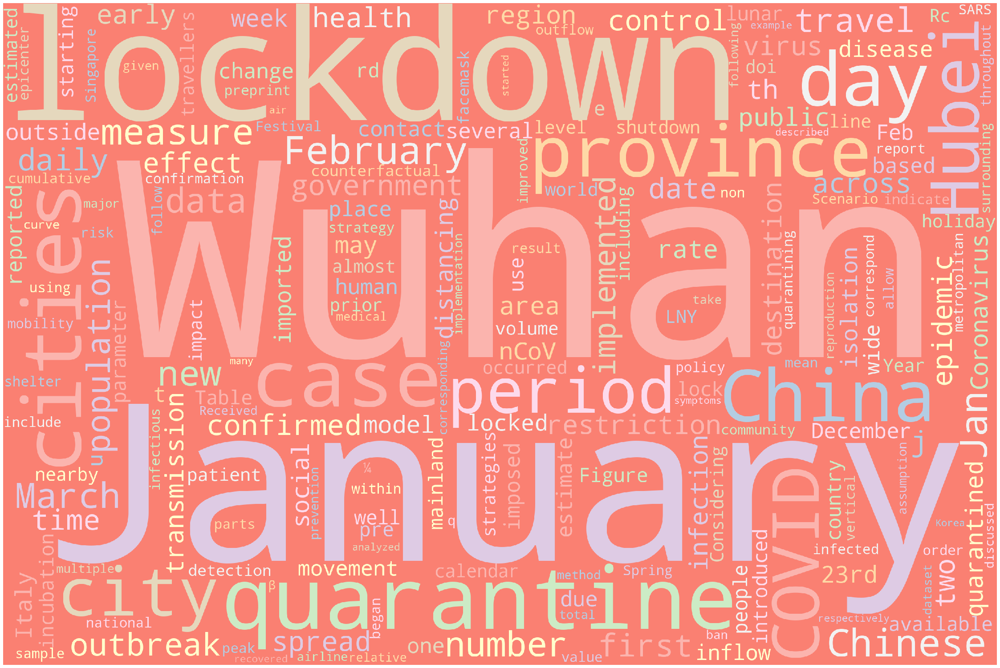

Topic Number 19
Topic Label lockdown reducing infections


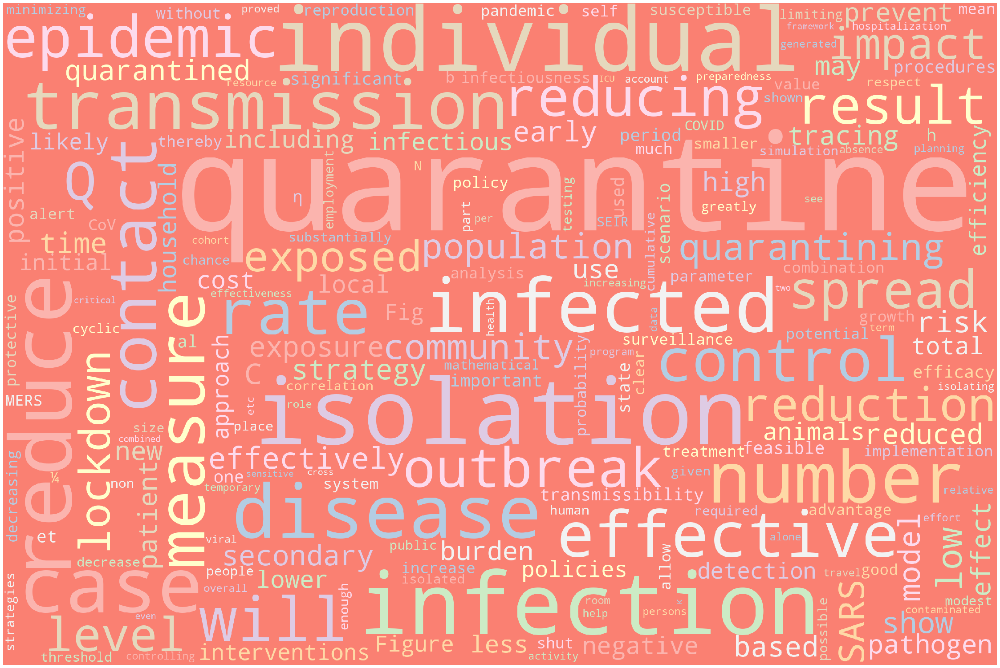

Topic Number 6
Topic Label canada


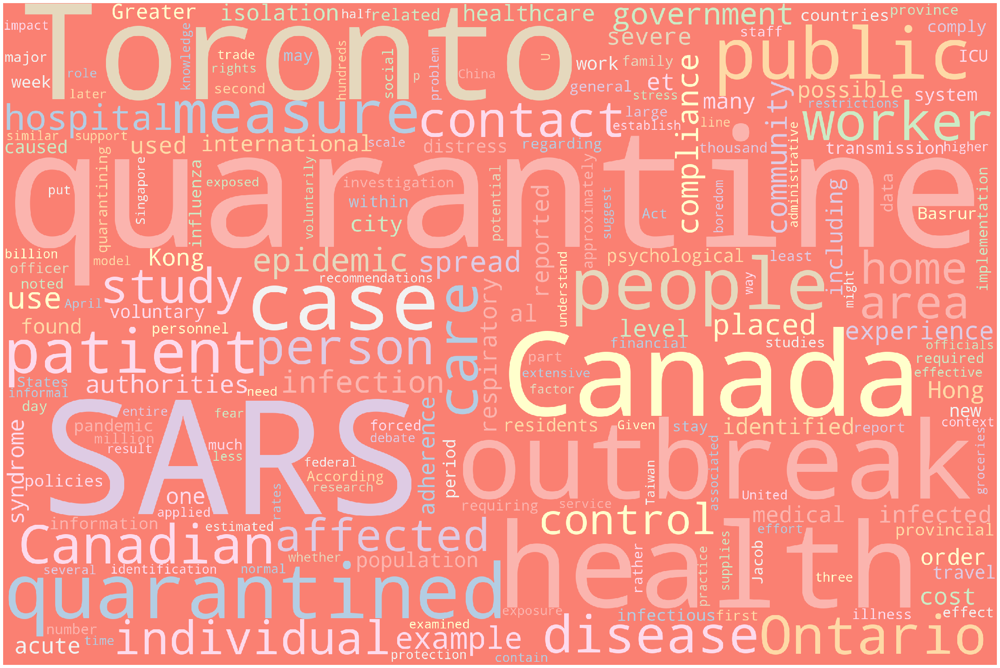

Topic Number 17
Topic Label increasing cases


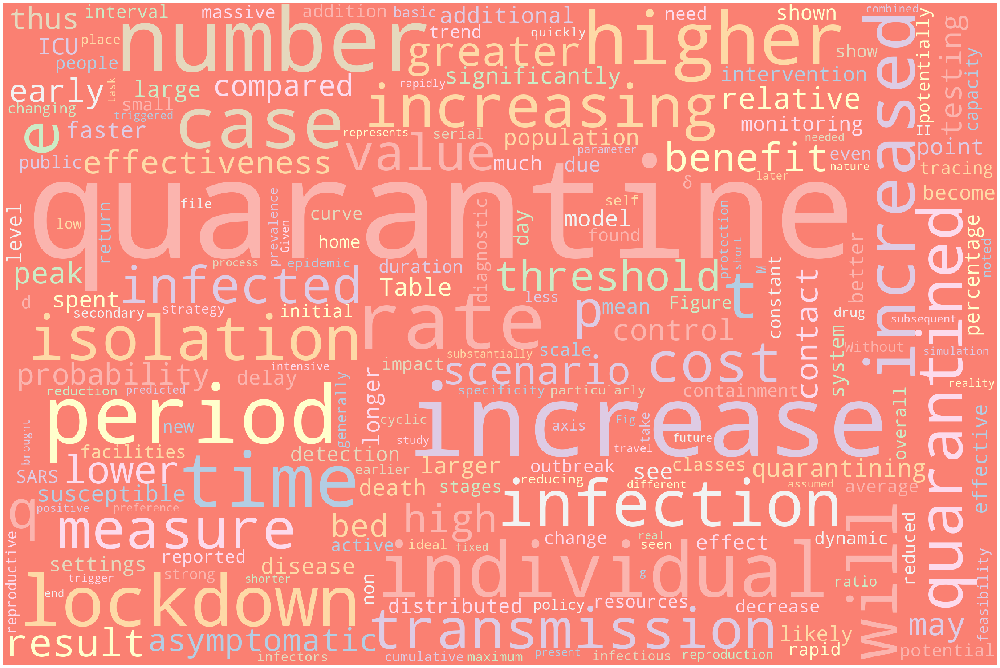

Topic Number 2
Topic Label australia


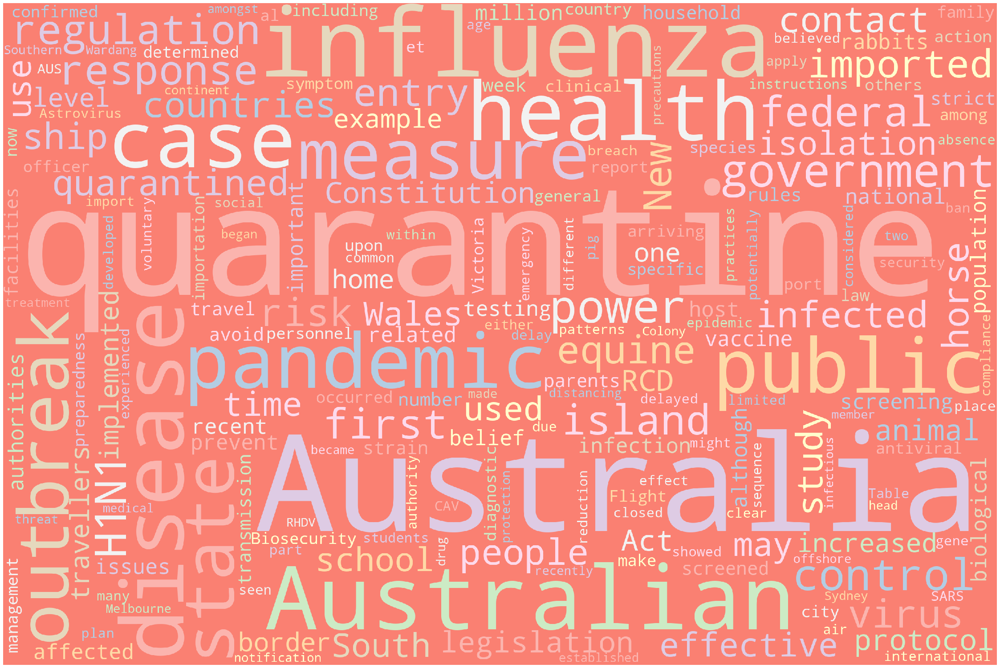

Topic Number 8
Topic Label sars


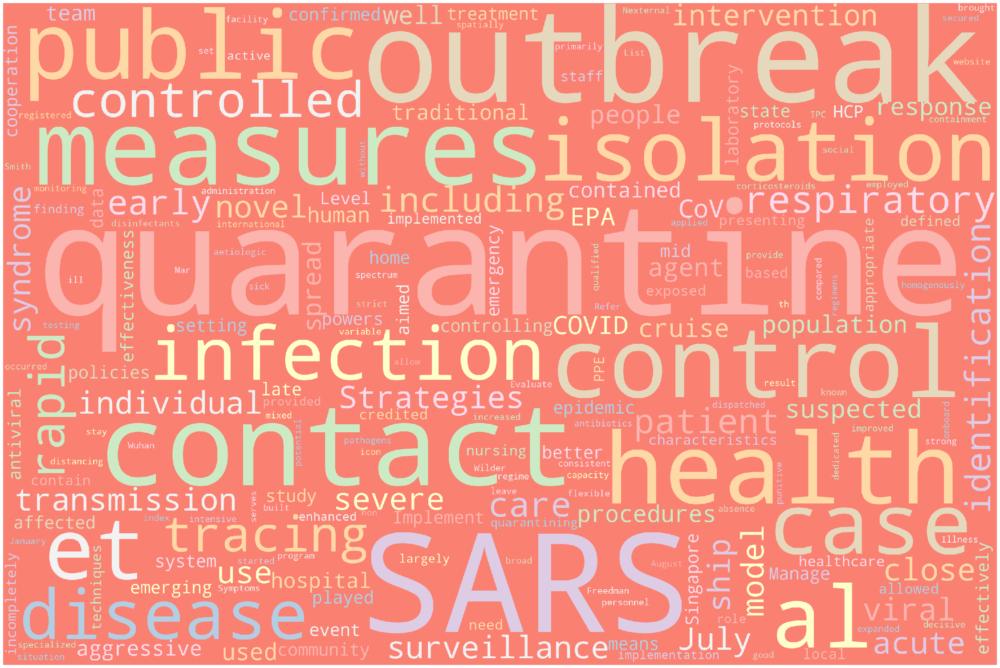

Topic Number 13
Topic Label authorities


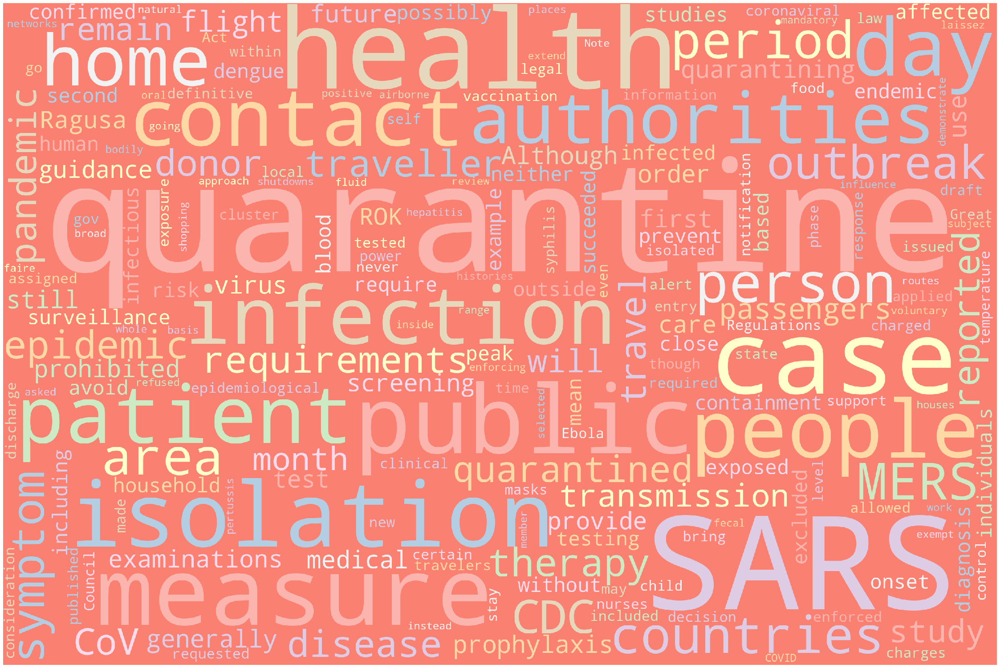

Topic Number 11
Topic Label copyright


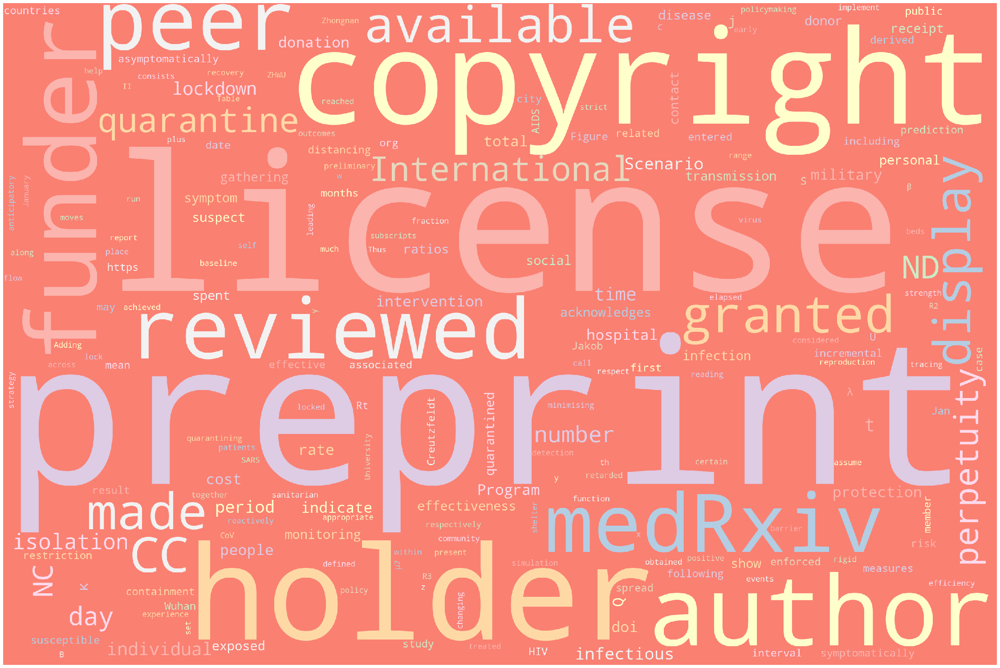

Topic Number 0
Topic Label electrical systems


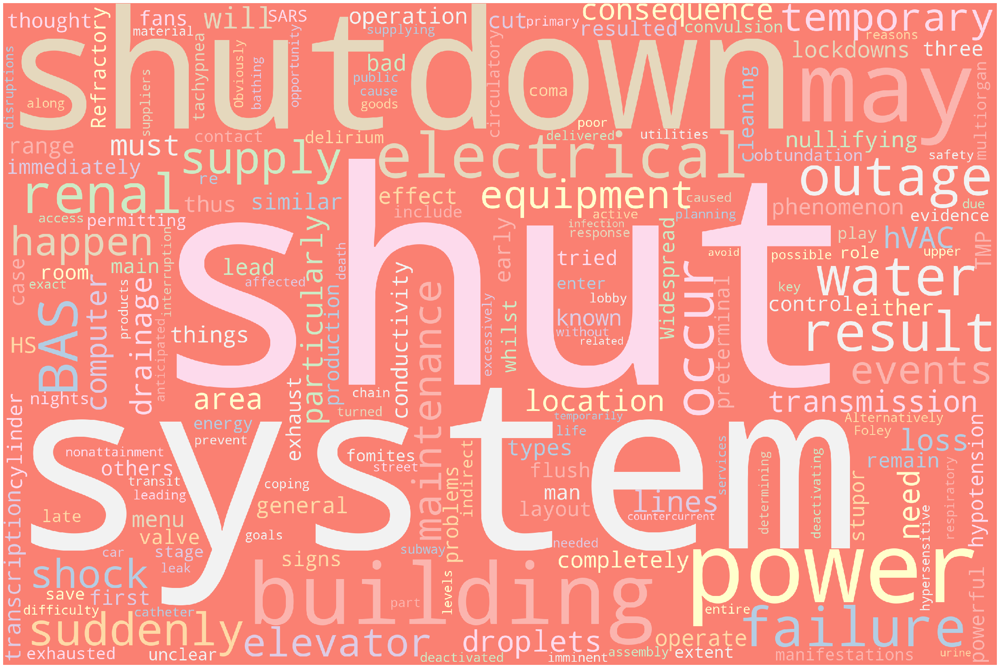

Topic Number 5
Topic Label cities in lockdown


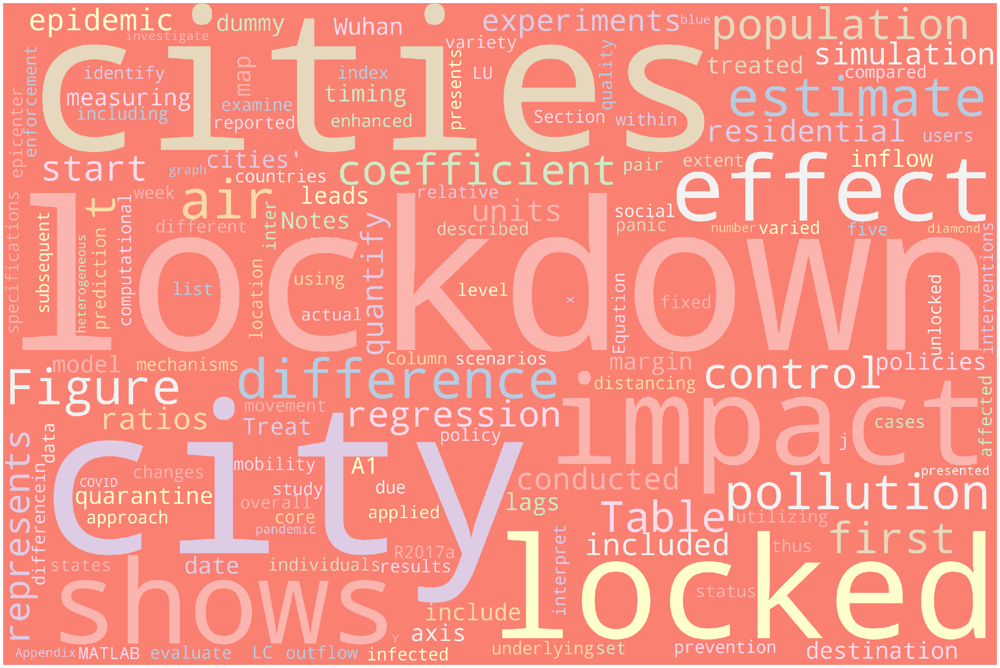

Topic Number 14
Topic Label japan


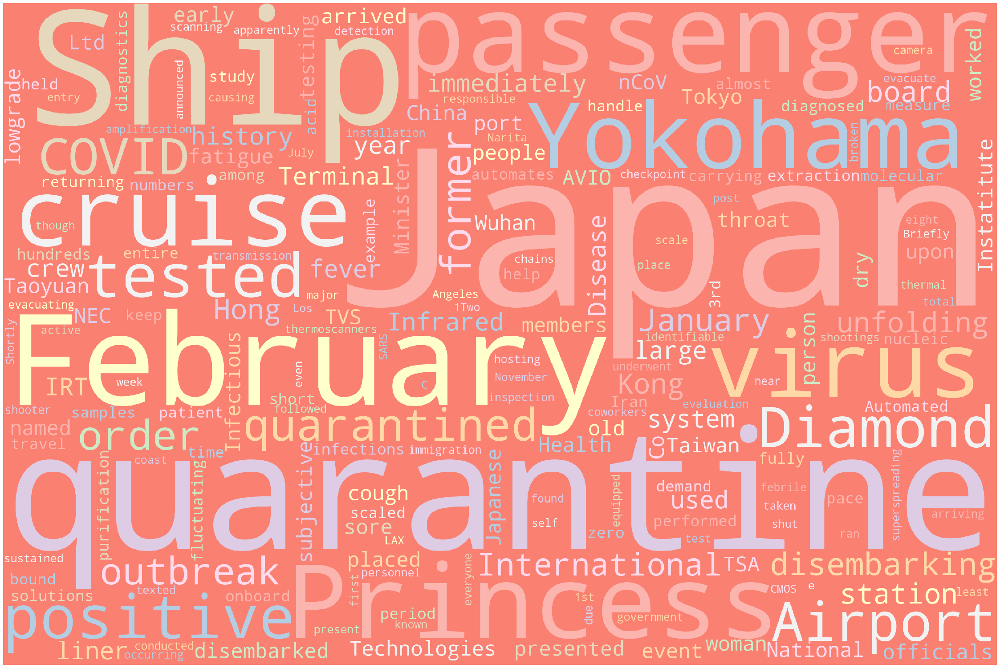

Topic Number 4
Topic Label links


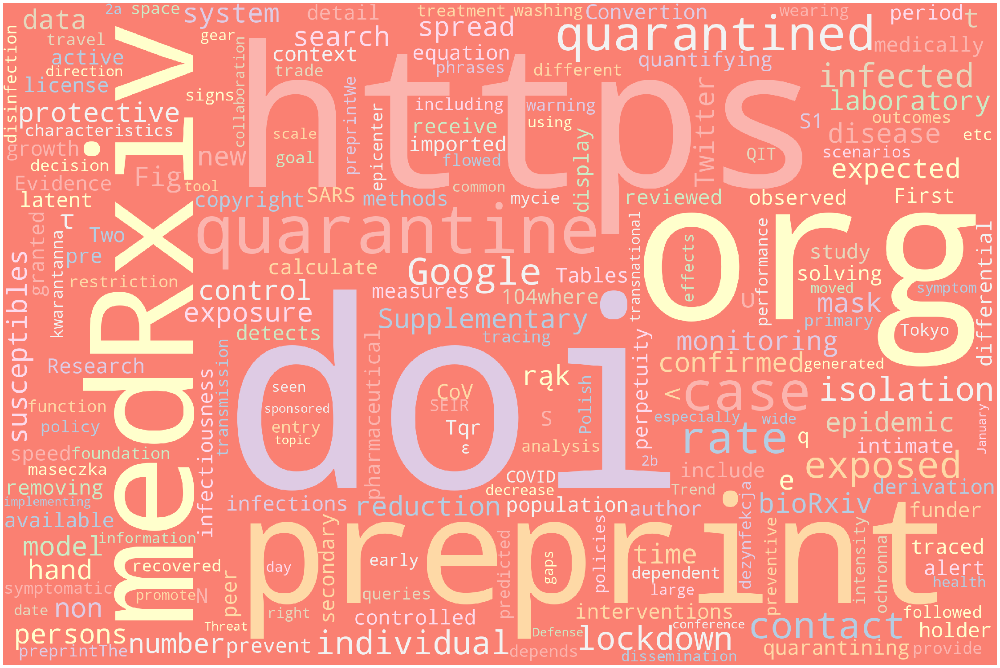

Topic Number 9
Topic Label thermoscanners


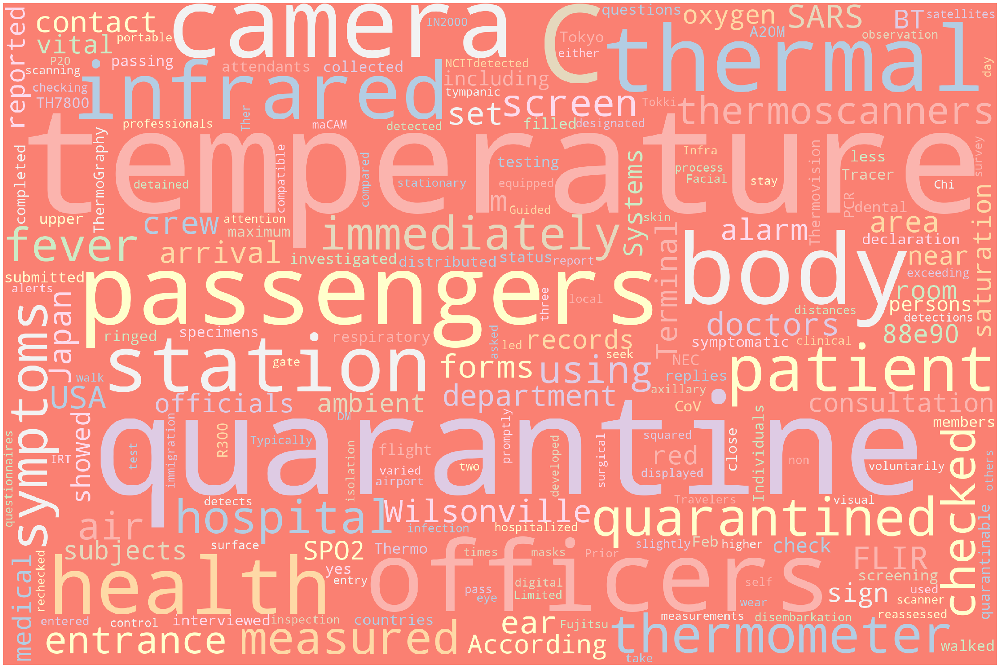

Topic Number -1
Topic Label outliers


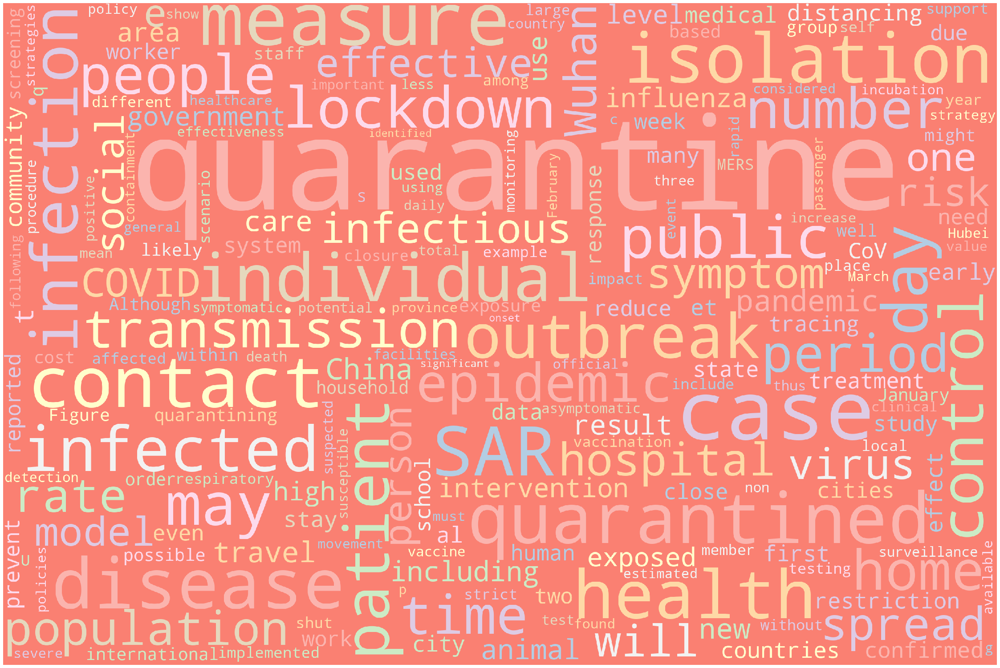

In [578]:
for topic, topic_label in topic_labels_dict.items():
    print('Topic Number {}'.format(topic))
    print('Topic Label {}'.format(topic_label))
    text = ' '.join(docs_df[docs_df['Topic']==topic]['Doc'].values)
    # Generate word cloud
    wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
    # Plot
    plot_cloud(wordcloud)